### Project | Module 3

## Project Goal
In this project, we will work on unsupervised machine learning. 
Imagine you are Uber and you want to give recommendations on where drivers should be to maximize their chances of finding a ride.
We will use Machine Learning to create this recommendation algorithm.

1. Try to see the number of optimal clusters
2. Find these clusters on a map
3. Now separate these clusters according to the time of day
4. Look at the difference between KMeans and DBSCAN

## Expectations

- Clean, well-commented code
- Clean data with EDA
- Clear board in Trello with logged time for each task
- Clear descriprion of each model
- At least 3 different models including Kmeans and DBSCAN
- Use Elbow method
- Use folium library to create the map
- Models implementation and comparison
- Vizualisation of the main results


## Deliverables

- '1. Uber.csv with clean and encoded data
- '2. Uber.ipynb' with all code concerning data cleaning and modelling
- '3. Slides/dashboard/notebook with your results (for each model and final table with models comparison).
- '4. Please state the conclusion about usability of each model.
- '5. Trello board.


Upon completion, add your deliverables to git. Then commit git and push your branch to the remote.

In [190]:
#Import your libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from datetime import datetime

from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
import folium
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.metrics import v_measure_score
from sklearn.metrics import silhouette_score, calinski_harabasz_score, completeness_score, homogeneity_score

# Data collection

In [337]:
data = pd.read_csv(r'C:\Users\ABR\Desktop\Projet8_Uber\uber-raw-data-aug14.csv')

In [339]:
data.shape

(829275, 4)

# EDA

In [341]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 829275 entries, 0 to 829274
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Date/Time  829275 non-null  object 
 1   Lat        829275 non-null  float64
 2   Lon        829275 non-null  float64
 3   Base       829275 non-null  object 
dtypes: float64(2), object(2)
memory usage: 25.3+ MB


In [342]:
data.head()

,Date/Time,Lat,Lon,Base
0,8/1/2014 0:03:00,40.7366,-73.9906,B02512
1,8/1/2014 0:09:00,40.7260,-73.9918,B02512
2,8/1/2014 0:12:00,40.7209,-74.0507,B02512
3,8/1/2014 0:12:00,40.7387,-73.9856,B02512
4,8/1/2014 0:12:00,40.7323,-74.0077,B02512


In [343]:
data.describe()

,Lat,Lon
count,829275.000000,829275.000000
mean,40.737781,-73.970160
std,0.043628,0.061483
min,39.656900,-74.773700
25%,40.719000,-73.995800
50%,40.740700,-73.982600
75%,40.760500,-73.961200
max,41.318200,-72.335900


<AxesSubplot:>

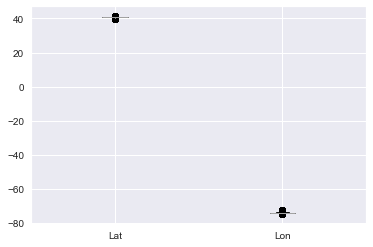

In [344]:
data.boxplot()

In [195]:
data['Date/Time']=pd.to_datetime(data['Date/Time'], format='%m/%d/%Y %H:%M:%S')

In [196]:
data

,Date/Time,Lat,Lon,Base
0,2014-08-01 00:03:00,40.7366,-73.9906,B02512
1,2014-08-01 00:09:00,40.7260,-73.9918,B02512
2,2014-08-01 00:12:00,40.7209,-74.0507,B02512
3,2014-08-01 00:12:00,40.7387,-73.9856,B02512
4,2014-08-01 00:12:00,40.7323,-74.0077,B02512
...,...,...,...,...
829270,2014-08-31 23:55:00,40.7552,-73.9753,B02764
829271,2014-08-31 23:55:00,40.7552,-73.9753,B02764
829272,2014-08-31 23:55:00,40.7617,-73.9788,B02764
829273,2014-08-31 23:59:00,40.7395,-73.9889,B02764


In [197]:
# create new columns with Month, day, hour data

data['date'] = data['Date/Time'].dt.date
data['month'] = data['Date/Time'].dt.month
data['MonthDayNum'] = data['Date/Time'].dt.day
data['HourOfDay'] = data['Date/Time'].dt.hour
data['DayOfWeekNum'] = data['Date/Time'].dt.dayofweek + 1 #Monday=1, Sunday=7.
data['DayOfWeek'] = data['Date/Time'].dt.day_name()

In [198]:
data

,Date/Time,Lat,Lon,Base,date,month,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
0,2014-08-01 00:03:00,40.7366,-73.9906,B02512,2014-08-01,8,1,0,5,Friday
1,2014-08-01 00:09:00,40.7260,-73.9918,B02512,2014-08-01,8,1,0,5,Friday
2,2014-08-01 00:12:00,40.7209,-74.0507,B02512,2014-08-01,8,1,0,5,Friday
3,2014-08-01 00:12:00,40.7387,-73.9856,B02512,2014-08-01,8,1,0,5,Friday
4,2014-08-01 00:12:00,40.7323,-74.0077,B02512,2014-08-01,8,1,0,5,Friday
...,...,...,...,...,...,...,...,...,...,...
829270,2014-08-31 23:55:00,40.7552,-73.9753,B02764,2014-08-31,8,31,23,7,Sunday
829271,2014-08-31 23:55:00,40.7552,-73.9753,B02764,2014-08-31,8,31,23,7,Sunday
829272,2014-08-31 23:55:00,40.7617,-73.9788,B02764,2014-08-31,8,31,23,7,Sunday
829273,2014-08-31 23:59:00,40.7395,-73.9889,B02764,2014-08-31,8,31,23,7,Sunday


In [199]:
data.drop('Date/Time', axis=1, inplace=True)

In [200]:
data.dtypes

Lat             float64
Lon             float64
Base             object
date             object
month             int64
MonthDayNum       int64
HourOfDay         int64
DayOfWeekNum      int64
DayOfWeek        object
dtype: object

Text(0.5, 1.0, 'MonthDayNum')

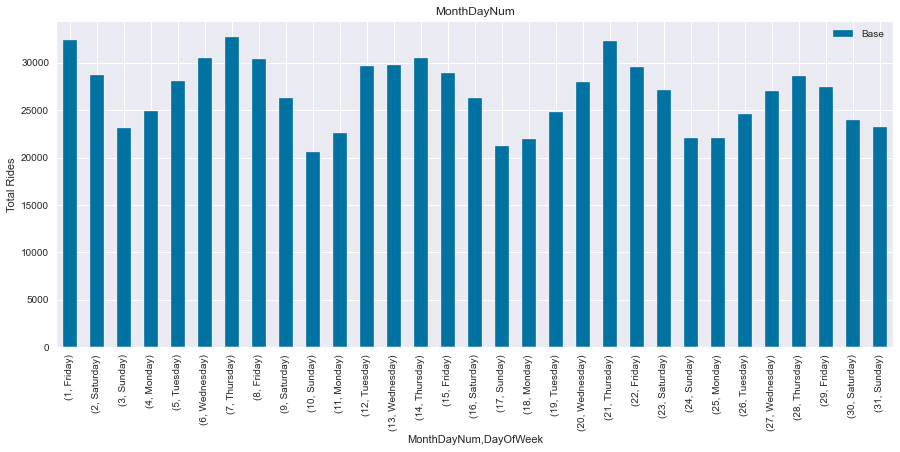

In [201]:
# visualize daily rides of the month

daily_uber_rides = data.pivot_table(index=['MonthDayNum', 'DayOfWeek'], values='Base', aggfunc='count')
daily_uber_rides.plot(kind='bar',figsize=(15,6))
plt.ylabel('Total Rides')
plt.title('MonthDayNum')

# Thursdays and Fridays have the highest number of rides, Sundays and Mondays have the least.

Text(0.5, 1.0, 'Days of the Week')

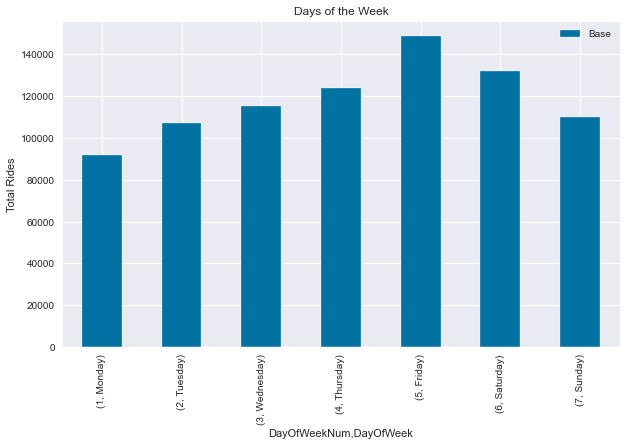

In [253]:
# visualize daily rides of a week

weekly_uber_rides = data.pivot_table(index=['DayOfWeekNum','DayOfWeek'], values='Base', aggfunc='count')
weekly_uber_rides.plot(kind='bar',figsize=(10,6))
plt.ylabel('Total Rides')
plt.title('Days of the Week')

# # Fridays and Saturdays have the highest number of rides, and Mondays have the least

In [251]:
# groupby table (rides per day of the week)
daily_uber_rides = data.groupby(['DayOfWeekNum','DayOfWeek'])['Base'].count()
daily_uber_rides = daily_uber_rides.reset_index()
daily_uber_rides

,DayOfWeekNum,DayOfWeek,Base
0,1,Monday,91633
1,2,Tuesday,107124
2,3,Wednesday,115256
3,4,Thursday,124117
4,5,Friday,148674
5,6,Saturday,132225
6,7,Sunday,110246


Text(0.5, 1.0, 'Rides by Hour')

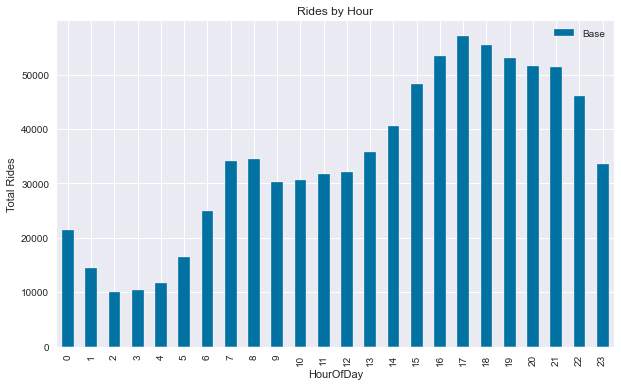

In [204]:
# check rides of each hour

hour_rides = data.pivot_table(index=['HourOfDay'], values='Base', aggfunc='count')
hour_rides.plot(kind='bar', figsize=(10,6))
plt.ylabel('Total Rides')
plt.title('Rides by Hour')

# peaks can be observed during commute hours 7H-9H and after 15H

In [205]:
# groupby table (rides per hour of the day)
hour_rides = data.groupby(['HourOfDay'])['Base'].count()
hour_rides = hour_rides.reset_index()
hour_rides

,HourOfDay,Base
0,0,21451
1,1,14471
2,2,10105
3,3,10376
4,4,11774
5,5,16525
6,6,24907
7,7,34064
8,8,34566
9,9,30195


In [206]:
# my asumption is that column Base is already our clusters 
# the different zone where the rides are booked
data['Base'].unique()

array(['B02512', 'B02598', 'B02617', 'B02682', 'B02764'], dtype=object)

## Elbow method to define number of clusters

In [207]:
X=data.sample(frac=0.01)

In [208]:
X

,Lat,Lon,Base,date,month,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
561765,40.7257,-73.9869,B02617,2014-08-27,8,27,17,3,Wednesday
371905,40.7253,-73.9959,B02617,2014-08-10,8,10,19,7,Sunday
386464,40.7439,-73.9838,B02617,2014-08-12,8,12,8,2,Tuesday
249189,40.7569,-73.9898,B02598,2014-08-31,8,31,16,7,Sunday
280059,40.7062,-73.9233,B02617,2014-08-03,8,3,4,7,Sunday
...,...,...,...,...,...,...,...,...,...
733760,40.7080,-74.0101,B02682,2014-08-22,8,22,18,5,Friday
271420,40.7430,-74.0001,B02617,2014-08-02,8,2,15,6,Saturday
696859,40.7416,-74.0032,B02682,2014-08-15,8,15,20,5,Friday
13126,40.7541,-73.9802,B02512,2014-08-12,8,12,18,2,Tuesday


In [209]:
X=X[["Lat","Lon"]]

# Kmeans

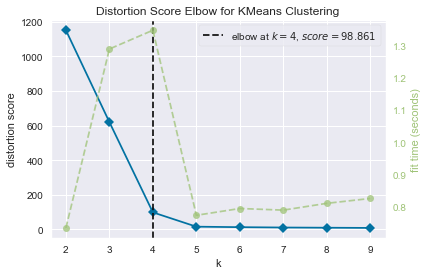

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [219]:
from sklearn.cluster import KMeans

#We check number of clusters for KMeans model
from yellowbrick.cluster import KElbowVisualizer
model = KMeans()
visualizer = KElbowVisualizer(estimator = model, k = (2,10)) # range of potential no. of cluster
visualizer.fit(X)
visualizer.poof()

In [220]:
model = KMeans(n_clusters=5)
y_kmeans=model.fit_predict(X)

C:\Users\ABR\AppData\Local\Temp\ipykernel_16948\2026307192.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['labels_kmeans'] = model.labels_


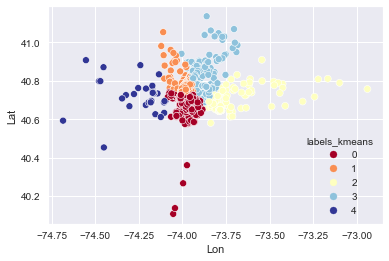

In [221]:
X['labels_kmeans'] = model.labels_

sns.set_style('darkgrid')
sns.scatterplot(data=X, x='Lon', y='Lat', hue='labels_kmeans', palette='RdYlBu')
plt.show()

In [222]:
X

,Lat,Lon,labels_kmeans
561765,40.7257,-73.9869,0
371905,40.7253,-73.9959,0
386464,40.7439,-73.9838,1
249189,40.7569,-73.9898,1
280059,40.7062,-73.9233,0
...,...,...,...
733760,40.7080,-74.0101,0
271420,40.7430,-74.0001,1
696859,40.7416,-74.0032,1
13126,40.7541,-73.9802,1


In [223]:
print('Silhouette Coefficient for KMeans is', silhouette_score(X[["Lat", "Lon"]], X["labels_kmeans"]))

Silhouette Coefficient for KMeans is 0.3850332568988621


####  Folium for Kmeans

In [224]:
#splitting the dataframe in five
data_map_list_cluster1kmeans = X[['Lat','Lon']][X['labels_kmeans']==0]
data_map_list_cluster2kmeans = X[['Lat','Lon']][X['labels_kmeans']==1]
data_map_list_cluster3kmeans = X[['Lat','Lon']][X['labels_kmeans']==2]
data_map_list_cluster4kmeans = X[['Lat','Lon']][X['labels_kmeans']==3]
data_map_list_cluster5kmeans = X[['Lat','Lon']][X['labels_kmeans']==4]

In [225]:
map = folium.Map(location=[X.Lat.mean(), X.Lon.mean()], zoom_start=12, control_scale=True, tiles = "Stamen Toner")

In [226]:
for index, location_info in data_map_list_cluster1kmeans.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='blue',fill_color='lightblue').add_to(map)
for index, location_info in data_map_list_cluster2kmeans.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='green',fill_color='lightgreen').add_to(map)
for index, location_info in data_map_list_cluster3kmeans.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='purple',fill_color='pink').add_to(map)
for index, location_info in data_map_list_cluster4kmeans.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='orange',fill_color='yellow').add_to(map)
for index, location_info in data_map_list_cluster5kmeans.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='red',fill_color='red').add_to(map)

In [227]:
map

# DBSCAN

In [228]:
X1=X[["Lat", "Lon"]]

In [229]:
dbscan = DBSCAN(eps=0.009, min_samples=50,n_jobs=-1)
dbscan.fit(X1)
y_dbscan = dbscan.fit_predict(X1)
y_dbscan

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

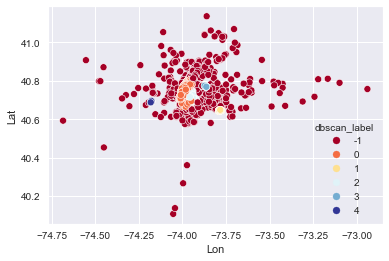

In [230]:
X1['dbscan_label'] =dbscan.labels_

sns.set_style('darkgrid')
sns.scatterplot(data=X1, x='Lon', y='Lat', hue='dbscan_label', palette='RdYlBu')
plt.show()

In [231]:
X1

,Lat,Lon,dbscan_label
561765,40.7257,-73.9869,0
371905,40.7253,-73.9959,0
386464,40.7439,-73.9838,0
249189,40.7569,-73.9898,0
280059,40.7062,-73.9233,2
...,...,...,...
733760,40.7080,-74.0101,0
271420,40.7430,-74.0001,0
696859,40.7416,-74.0032,0
13126,40.7541,-73.9802,0


In [232]:
print('Silhouette Coefficient for DBSCAN is', silhouette_score(X1[["Lat", "Lon"]], X1["dbscan_label"]))

Silhouette Coefficient for DBSCAN is 0.25207451733075925


####  Folium for DBSCAN

In [233]:
#splitting the dataframe in five
data_map_list_cluster1Dbscan = X1[['Lat','Lon']][X1['dbscan_label']==0]
data_map_list_cluster2Dbscan = X1[['Lat','Lon']][X1['dbscan_label']==1]
data_map_list_cluster3Dbscan = X1[['Lat','Lon']][X1['dbscan_label']==2]
data_map_list_cluster4Dbscan = X1[['Lat','Lon']][X1['dbscan_label']==3]
data_map_list_cluster5Dbscan = X1[['Lat','Lon']][X1['dbscan_label']==4]

In [234]:
map = folium.Map(location=[X1.Lat.mean(), X1.Lon.mean()], zoom_start=12, control_scale=True, tiles = "Stamen Toner")

In [235]:
for index, location_info in data_map_list_cluster1Dbscan.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='blue',fill_color='lightblue').add_to(map)
for index, location_info in data_map_list_cluster2Dbscan.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='green',fill_color='lightgreen').add_to(map)
for index, location_info in data_map_list_cluster3Dbscan.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='purple',fill_color='pink').add_to(map)
for index, location_info in data_map_list_cluster4Dbscan.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='orange',fill_color='yellow').add_to(map)
for index, location_info in data_map_list_cluster5Dbscan.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='red',fill_color='red').add_to(map)

In [236]:
map

# Agglomerative Clustering

In [237]:
from sklearn.cluster import AgglomerativeClustering

In [238]:
X2=X[["Lat", "Lon"]]

In [239]:
cluster_agg = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')  
y_agg=cluster_agg.fit_predict(X2)

In [240]:
X2['agg_labels'] =cluster_agg.labels_

In [241]:
X2

,Lat,Lon,agg_labels
561765,40.7257,-73.9869,2
371905,40.7253,-73.9959,2
386464,40.7439,-73.9838,2
249189,40.7569,-73.9898,4
280059,40.7062,-73.9233,2
...,...,...,...
733760,40.7080,-74.0101,2
271420,40.7430,-74.0001,2
696859,40.7416,-74.0032,2
13126,40.7541,-73.9802,4


In [242]:
print('Silhouette Coefficient for agglomerativClustering is', silhouette_score(X2[["Lat", "Lon"]], X2["agg_labels"]))

Silhouette Coefficient for agglomerativClustering is 0.35911820899985303


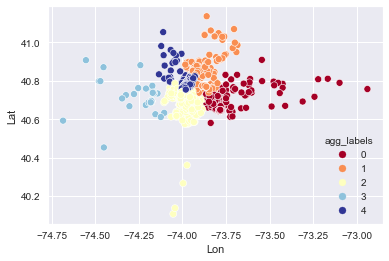

In [243]:
#Plotting clusters
sns.set_style('darkgrid')
sns.scatterplot(data=X2, x='Lon', y='Lat', hue='agg_labels', palette='RdYlBu')
plt.show()

####  Folium for Agglomerative Clustering


In [244]:
#splitting the dataframe in five
data_map_list_cluster1AggC = X2[['Lat','Lon']][X2['agg_labels']==0]
data_map_list_cluster2AggC = X2[['Lat','Lon']][X2['agg_labels']==1]
data_map_list_cluster3AggC = X2[['Lat','Lon']][X2['agg_labels']==2]
data_map_list_cluster4AggC = X2[['Lat','Lon']][X2['agg_labels']==3]
data_map_list_cluster5AggC = X2[['Lat','Lon']][X2['agg_labels']==4]

In [245]:
map = folium.Map(location=[X2.Lat.mean(), X2.Lon.mean()], zoom_start=12, control_scale=True, tiles = "Stamen Toner")

In [246]:
for index, location_info in data_map_list_cluster1AggC.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='blue',fill_color='lightblue').add_to(map)
for index, location_info in data_map_list_cluster2AggC.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='green',fill_color='lightgreen').add_to(map)
for index, location_info in data_map_list_cluster3AggC.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='purple',fill_color='pink').add_to(map)
for index, location_info in data_map_list_cluster4AggC.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='orange',fill_color='yellow').add_to(map)
for index, location_info in data_map_list_cluster5AggC.iterrows():
    folium.CircleMarker([location_info['Lat'], location_info['Lon']], color='red',fill_color='red').add_to(map)

In [247]:
map

# Model Evaluation

In [248]:
print('Silhouette Coefficient for agglomerativClustering is', silhouette_score(X2[["Lat", "Lon"]], X2["agg_labels"]))
print('Silhouette Coefficient for DBSCAN is', silhouette_score(X1[["Lat", "Lon"]], X1["dbscan_label"]))
print('Silhouette Coefficient for KMeans is', silhouette_score(X[["Lat", "Lon"]], X["labels_kmeans"]))

Silhouette Coefficient for agglomerativClustering is 0.35911820899985303
Silhouette Coefficient for DBSCAN is 0.25207451733075925
Silhouette Coefficient for KMeans is 0.3850332568988621


# Folium for the 7 days of the week

In [254]:
weekly_uber_rides

,,Base
DayOfWeekNum,DayOfWeek,
1,Monday,91633
2,Tuesday,107124
3,Wednesday,115256
4,Thursday,124117
5,Friday,148674
6,Saturday,132225
7,Sunday,110246


In [255]:
X

,Lat,Lon,labels_kmeans
561765,40.7257,-73.9869,0
371905,40.7253,-73.9959,0
386464,40.7439,-73.9838,1
249189,40.7569,-73.9898,1
280059,40.7062,-73.9233,0
...,...,...,...
733760,40.7080,-74.0101,0
271420,40.7430,-74.0001,1
696859,40.7416,-74.0032,1
13126,40.7541,-73.9802,1


In [259]:
days_model=X.merge(data, left_index= True, right_index= True)

In [260]:
days_model

,Lat_x,Lon_x,labels_kmeans,Lat_y,Lon_y,Base,date,month,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
561765,40.7257,-73.9869,0,40.7257,-73.9869,B02617,2014-08-27,8,27,17,3,Wednesday
371905,40.7253,-73.9959,0,40.7253,-73.9959,B02617,2014-08-10,8,10,19,7,Sunday
386464,40.7439,-73.9838,1,40.7439,-73.9838,B02617,2014-08-12,8,12,8,2,Tuesday
249189,40.7569,-73.9898,1,40.7569,-73.9898,B02598,2014-08-31,8,31,16,7,Sunday
280059,40.7062,-73.9233,0,40.7062,-73.9233,B02617,2014-08-03,8,3,4,7,Sunday
...,...,...,...,...,...,...,...,...,...,...,...,...
733760,40.7080,-74.0101,0,40.7080,-74.0101,B02682,2014-08-22,8,22,18,5,Friday
271420,40.7430,-74.0001,1,40.7430,-74.0001,B02617,2014-08-02,8,2,15,6,Saturday
696859,40.7416,-74.0032,1,40.7416,-74.0032,B02682,2014-08-15,8,15,20,5,Friday
13126,40.7541,-73.9802,1,40.7541,-73.9802,B02512,2014-08-12,8,12,18,2,Tuesday


In [264]:
days_model.drop('Lat_y', axis=1,inplace=True)

In [265]:
days_model.drop('Lon_y', axis=1,inplace=True)

In [266]:
days_model.drop('date', axis=1,inplace=True)

In [267]:
days_model.drop('month', axis=1,inplace=True)

In [268]:
days_model

,Lat_x,Lon_x,labels_kmeans,Base,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
561765,40.7257,-73.9869,0,B02617,27,17,3,Wednesday
371905,40.7253,-73.9959,0,B02617,10,19,7,Sunday
386464,40.7439,-73.9838,1,B02617,12,8,2,Tuesday
249189,40.7569,-73.9898,1,B02598,31,16,7,Sunday
280059,40.7062,-73.9233,0,B02617,3,4,7,Sunday
...,...,...,...,...,...,...,...,...
733760,40.7080,-74.0101,0,B02682,22,18,5,Friday
271420,40.7430,-74.0001,1,B02617,2,15,6,Saturday
696859,40.7416,-74.0032,1,B02682,15,20,5,Friday
13126,40.7541,-73.9802,1,B02512,12,18,2,Tuesday


# Monday

In [269]:
monday_model=days_model[days_model['DayOfWeekNum']== 1]

In [270]:
monday_model

,Lat_x,Lon_x,labels_kmeans,Base,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
670248,40.7490,-73.9730,1,B02682,11,10,1,Monday
747062,40.7237,-73.9964,0,B02682,25,11,1,Monday
4300,40.7640,-73.9772,1,B02512,4,20,1,Monday
377016,40.7423,-74.0045,1,B02617,11,10,1,Monday
381072,40.7000,-73.9879,0,B02617,11,18,1,Monday
...,...,...,...,...,...,...,...,...
376783,40.7495,-73.9918,1,B02617,11,10,1,Monday
811053,40.7528,-73.9794,1,B02764,25,20,1,Monday
810172,40.7228,-74.0048,0,B02764,25,13,1,Monday
543827,40.7175,-74.0144,0,B02617,25,21,1,Monday


In [271]:
#splitting the dataframe in five
data_map_list_cluster1kmeans_monday = monday_model[['Lat_x','Lon_x']][monday_model['labels_kmeans']==0]
data_map_list_cluster2kmeans_monday = monday_model[['Lat_x','Lon_x']][monday_model['labels_kmeans']==1]
data_map_list_cluster3kmeans_monday = monday_model[['Lat_x','Lon_x']][monday_model['labels_kmeans']==2]
data_map_list_cluster4kmeans_monday = monday_model[['Lat_x','Lon_x']][monday_model['labels_kmeans']==3]
data_map_list_cluster5kmeans_monday = monday_model[['Lat_x','Lon_x']][monday_model['labels_kmeans']==4]

In [272]:
map = folium.Map(location=[monday_model.Lat_x.mean(), monday_model.Lon_x.mean()], zoom_start=12, control_scale=True, tiles = "Stamen Toner")

In [275]:
for index, location_info in data_map_list_cluster1kmeans_monday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='blue',fill_color='lightblue').add_to(map)
for index, location_info in data_map_list_cluster2kmeans_monday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='green',fill_color='lightgreen').add_to(map)
for index, location_info in data_map_list_cluster3kmeans_monday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='purple',fill_color='pink').add_to(map)
for index, location_info in data_map_list_cluster4kmeans_monday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='orange',fill_color='yellow').add_to(map)
for index, location_info in data_map_list_cluster5kmeans_monday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='red',fill_color='red').add_to(map)

In [276]:
map

# Tuesday

In [277]:
tuesday_model=days_model[days_model['DayOfWeekNum']== 2]

In [278]:
tuesday_model

,Lat_x,Lon_x,labels_kmeans,Base,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
386464,40.7439,-73.9838,1,B02617,12,8,2,Tuesday
675026,40.7495,-73.9819,1,B02682,12,10,2,Tuesday
304519,40.7459,-73.9813,1,B02617,5,13,2,Tuesday
301150,40.7682,-73.9894,1,B02617,5,7,2,Tuesday
119705,40.7351,-73.9879,1,B02598,12,17,2,Tuesday
...,...,...,...,...,...,...,...,...
216114,40.7299,-74.0006,0,B02598,26,14,2,Tuesday
466408,40.6758,-73.9714,0,B02617,19,1,2,Tuesday
386811,40.7517,-73.9773,1,B02617,12,9,2,Tuesday
309531,40.6907,-73.8478,2,B02617,5,19,2,Tuesday


In [279]:
data_map_list_cluster1kmeans_tuesday = tuesday_model[['Lat_x','Lon_x']][tuesday_model['labels_kmeans']==0]
data_map_list_cluster2kmeans_tuesday = tuesday_model[['Lat_x','Lon_x']][tuesday_model['labels_kmeans']==1]
data_map_list_cluster3kmeans_tuesday = tuesday_model[['Lat_x','Lon_x']][tuesday_model['labels_kmeans']==2]
data_map_list_cluster4kmeans_tuesday = tuesday_model[['Lat_x','Lon_x']][tuesday_model['labels_kmeans']==3]
data_map_list_cluster5kmeans_tuesday = tuesday_model[['Lat_x','Lon_x']][tuesday_model['labels_kmeans']==4]

In [280]:
map = folium.Map(location=[tuesday_model.Lat_x.mean(), tuesday_model.Lon_x.mean()], zoom_start=12, control_scale=True, tiles = "Stamen Toner")

In [281]:
for index, location_info in data_map_list_cluster1kmeans_tuesday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='blue',fill_color='lightblue').add_to(map)
for index, location_info in data_map_list_cluster2kmeans_tuesday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='green',fill_color='lightgreen').add_to(map)
for index, location_info in data_map_list_cluster3kmeans_tuesday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='purple',fill_color='pink').add_to(map)
for index, location_info in data_map_list_cluster4kmeans_tuesday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='orange',fill_color='yellow').add_to(map)
for index, location_info in data_map_list_cluster5kmeans_tuesday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='red',fill_color='red').add_to(map)

In [282]:
map

# Wednesday

In [283]:
wednesday_model=days_model[days_model['DayOfWeekNum']== 3]

In [284]:
wednesday_model

,Lat_x,Lon_x,labels_kmeans,Base,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
561765,40.7257,-73.9869,0,B02617,27,17,3,Wednesday
756596,40.7304,-74.0019,0,B02682,27,10,3,Wednesday
555219,40.7422,-74.0007,1,B02617,27,4,3,Wednesday
476894,40.7900,-73.9655,1,B02617,20,0,3,Wednesday
755900,40.7641,-73.9813,1,B02682,27,7,3,Wednesday
...,...,...,...,...,...,...,...,...
798123,40.7218,-73.9581,0,B02764,20,1,3,Wednesday
400443,40.7334,-74.0046,0,B02617,13,9,3,Wednesday
787900,40.7443,-73.9803,1,B02764,13,0,3,Wednesday
129023,40.7245,-74.0090,0,B02598,13,18,3,Wednesday


In [285]:
data_map_list_cluster1kmeans_wednesday = wednesday_model[['Lat_x','Lon_x']][wednesday_model['labels_kmeans']==0]
data_map_list_cluster2kmeans_wednesday = wednesday_model[['Lat_x','Lon_x']][wednesday_model['labels_kmeans']==1]
data_map_list_cluster3kmeans_wednesday = wednesday_model[['Lat_x','Lon_x']][wednesday_model['labels_kmeans']==2]
data_map_list_cluster4kmeans_wednesday = wednesday_model[['Lat_x','Lon_x']][wednesday_model['labels_kmeans']==3]
data_map_list_cluster5kmeans_wednesday = wednesday_model[['Lat_x','Lon_x']][wednesday_model['labels_kmeans']==4]

In [286]:
map = folium.Map(location=[wednesday_model.Lat_x.mean(), wednesday_model.Lon_x.mean()], zoom_start=12, control_scale=True, tiles = "Stamen Toner")

In [287]:
for index, location_info in data_map_list_cluster1kmeans_wednesday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='blue',fill_color='lightblue').add_to(map)
for index, location_info in data_map_list_cluster2kmeans_wednesday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='green',fill_color='lightgreen').add_to(map)
for index, location_info in data_map_list_cluster3kmeans_wednesday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='purple',fill_color='pink').add_to(map)
for index, location_info in data_map_list_cluster4kmeans_wednesday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='orange',fill_color='yellow').add_to(map)
for index, location_info in data_map_list_cluster5kmeans_wednesday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='red',fill_color='red').add_to(map)

In [288]:
map

# Thursday

In [289]:
thursday_model=days_model[days_model['DayOfWeekNum']== 4]

In [290]:
thursday_model

,Lat_x,Lon_x,labels_kmeans,Base,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
724136,40.7167,-74.0144,0,B02682,21,8,4,Thursday
501307,40.7198,-73.9999,0,B02617,21,22,4,Thursday
566831,40.7753,-73.9554,1,B02617,28,6,4,Thursday
339473,40.6647,-73.9935,0,B02617,7,23,4,Thursday
725280,40.7310,-73.9612,0,B02682,21,13,4,Thursday
...,...,...,...,...,...,...,...,...
496720,40.7561,-73.9978,1,B02617,21,18,4,Thursday
494981,40.7341,-74.0632,0,B02617,21,16,4,Thursday
494038,40.7261,-73.9918,0,B02617,21,14,4,Thursday
80771,40.7254,-73.9893,0,B02598,7,11,4,Thursday


In [292]:
data_map_list_cluster1kmeans_thursday = thursday_model[['Lat_x','Lon_x']][thursday_model['labels_kmeans']==0]
data_map_list_cluster2kmeans_thursday = thursday_model[['Lat_x','Lon_x']][thursday_model['labels_kmeans']==1]
data_map_list_cluster3kmeans_thursday = thursday_model[['Lat_x','Lon_x']][thursday_model['labels_kmeans']==2]
data_map_list_cluster4kmeans_thursday = thursday_model[['Lat_x','Lon_x']][thursday_model['labels_kmeans']==3]
data_map_list_cluster5kmeans_thursday = thursday_model[['Lat_x','Lon_x']][thursday_model['labels_kmeans']==4]

In [293]:
map = folium.Map(location=[thursday_model.Lat_x.mean(), thursday_model.Lon_x.mean()], zoom_start=12, control_scale=True, tiles = "Stamen Toner")

In [294]:
for index, location_info in data_map_list_cluster1kmeans_thursday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='blue',fill_color='lightblue').add_to(map)
for index, location_info in data_map_list_cluster2kmeans_thursday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='green',fill_color='lightgreen').add_to(map)
for index, location_info in data_map_list_cluster3kmeans_thursday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='purple',fill_color='pink').add_to(map)
for index, location_info in data_map_list_cluster4kmeans_thursday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='orange',fill_color='yellow').add_to(map)
for index, location_info in data_map_list_cluster5kmeans_thursday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='red',fill_color='red').add_to(map)

In [295]:
map

# Friday

In [305]:
friday_model=days_model[days_model['DayOfWeekNum']== 5]

In [306]:
friday_model

,Lat_x,Lon_x,labels_kmeans,Base,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
91156,40.7282,-73.9866,0,B02598,8,14,5,Friday
820554,40.7892,-73.9528,1,B02764,29,10,5,Friday
768925,40.7154,-74.0143,0,B02682,29,15,5,Friday
803039,40.7843,-73.9738,1,B02764,22,10,5,Friday
582711,40.6432,-73.7897,2,B02617,29,15,5,Friday
...,...,...,...,...,...,...,...,...
503811,40.7804,-73.9559,1,B02617,22,6,5,Friday
235105,40.7249,-74.0005,0,B02598,29,9,5,Friday
581037,40.7404,-73.9983,1,B02617,29,11,5,Friday
733760,40.7080,-74.0101,0,B02682,22,18,5,Friday


In [307]:
data_map_list_cluster1kmeans_friday = friday_model[['Lat_x','Lon_x']][friday_model['labels_kmeans']==0]
data_map_list_cluster2kmeans_friday = friday_model[['Lat_x','Lon_x']][friday_model['labels_kmeans']==1]
data_map_list_cluster3kmeans_friday = friday_model[['Lat_x','Lon_x']][friday_model['labels_kmeans']==2]
data_map_list_cluster4kmeans_friday = friday_model[['Lat_x','Lon_x']][friday_model['labels_kmeans']==3]
data_map_list_cluster5kmeans_friday = friday_model[['Lat_x','Lon_x']][friday_model['labels_kmeans']==4]

In [308]:
map = folium.Map(location=[friday_model.Lat_x.mean(), friday_model.Lon_x.mean()], zoom_start=12, control_scale=True, tiles = "Stamen Toner")

In [309]:
for index, location_info in data_map_list_cluster1kmeans_friday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='blue',fill_color='lightblue').add_to(map)
for index, location_info in data_map_list_cluster2kmeans_friday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='green',fill_color='lightgreen').add_to(map)
for index, location_info in data_map_list_cluster3kmeans_friday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='purple',fill_color='pink').add_to(map)
for index, location_info in data_map_list_cluster4kmeans_friday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='orange',fill_color='yellow').add_to(map)
for index, location_info in data_map_list_cluster5kmeans_friday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='red',fill_color='red').add_to(map)

In [310]:
map

# Saturday

In [311]:
saturday_model=days_model[days_model['DayOfWeekNum']== 6]

In [312]:
saturday_model

,Lat_x,Lon_x,labels_kmeans,Base,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
440844,40.5756,-73.9794,0,B02617,16,15,6,Saturday
439784,40.7958,-73.9755,1,B02617,16,13,6,Saturday
244101,40.7521,-73.9854,1,B02598,30,18,6,Saturday
825386,40.7302,-73.9555,0,B02764,30,19,6,Saturday
102251,40.7471,-73.9723,1,B02598,9,21,6,Saturday
...,...,...,...,...,...,...,...,...
150862,40.6948,-73.9481,0,B02598,16,16,6,Saturday
268942,40.7420,-74.0039,1,B02617,2,11,6,Saturday
359753,40.6873,-73.9124,0,B02617,9,17,6,Saturday
271420,40.7430,-74.0001,1,B02617,2,15,6,Saturday


In [313]:
data_map_list_cluster1kmeans_saturday = saturday_model[['Lat_x','Lon_x']][saturday_model['labels_kmeans']==0]
data_map_list_cluster2kmeans_saturday = saturday_model[['Lat_x','Lon_x']][saturday_model['labels_kmeans']==1]
data_map_list_cluster3kmeans_saturday = saturday_model[['Lat_x','Lon_x']][saturday_model['labels_kmeans']==2]
data_map_list_cluster4kmeans_saturday = saturday_model[['Lat_x','Lon_x']][saturday_model['labels_kmeans']==3]
data_map_list_cluster5kmeans_saturday = saturday_model[['Lat_x','Lon_x']][saturday_model['labels_kmeans']==4]

In [314]:
map = folium.Map(location=[saturday_model.Lat_x.mean(), saturday_model.Lon_x.mean()], zoom_start=12, control_scale=True, tiles = "Stamen Toner")

In [315]:
for index, location_info in data_map_list_cluster1kmeans_saturday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='blue',fill_color='lightblue').add_to(map)
for index, location_info in data_map_list_cluster2kmeans_saturday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='green',fill_color='lightgreen').add_to(map)
for index, location_info in data_map_list_cluster3kmeans_saturday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='purple',fill_color='pink').add_to(map)
for index, location_info in data_map_list_cluster4kmeans_saturday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='orange',fill_color='yellow').add_to(map)
for index, location_info in data_map_list_cluster5kmeans_saturday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='red',fill_color='red').add_to(map)

In [316]:
map

# Sunday

In [326]:
sunday_model=days_model[days_model['DayOfWeekNum']== 7]

In [327]:
sunday_model

,Lat_x,Lon_x,labels_kmeans,Base,MonthDayNum,HourOfDay,DayOfWeekNum,DayOfWeek
371905,40.7253,-73.9959,0,B02617,10,19,7,Sunday
249189,40.7569,-73.9898,1,B02598,31,16,7,Sunday
280059,40.7062,-73.9233,0,B02617,3,4,7,Sunday
447359,40.7341,-74.0029,0,B02617,17,0,7,Sunday
107083,40.6417,-73.7888,2,B02598,10,17,7,Sunday
...,...,...,...,...,...,...,...,...
368146,40.7678,-73.9917,1,B02617,10,11,7,Sunday
372953,40.7741,-73.8726,3,B02617,10,20,7,Sunday
372278,40.7686,-73.8627,3,B02617,10,19,7,Sunday
279370,40.7086,-73.9383,0,B02617,3,1,7,Sunday


In [328]:
data_map_list_cluster1kmeans_sunday = sunday_model[['Lat_x','Lon_x']][sunday_model['labels_kmeans']==0]
data_map_list_cluster2kmeans_sunday = sunday_model[['Lat_x','Lon_x']][sunday_model['labels_kmeans']==1]
data_map_list_cluster3kmeans_sunday = sunday_model[['Lat_x','Lon_x']][sunday_model['labels_kmeans']==2]
data_map_list_cluster4kmeans_sunday = sunday_model[['Lat_x','Lon_x']][sunday_model['labels_kmeans']==3]
data_map_list_cluster5kmeans_sunday = sunday_model[['Lat_x','Lon_x']][sunday_model['labels_kmeans']==4]

In [333]:
map = folium.Map(location=[sunday_model.Lat_x.mean(), sunday_model.Lon_x.mean()], zoom_start=12, control_scale=True, tiles = "Stamen Toner")

In [334]:
for index, location_info in data_map_list_cluster1kmeans_sunday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='blue',fill_color='lightblue').add_to(map)
for index, location_info in data_map_list_cluster2kmeans_sunday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='green',fill_color='lightgreen').add_to(map)
for index, location_info in data_map_list_cluster3kmeans_sunday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='purple',fill_color='pink').add_to(map)
for index, location_info in data_map_list_cluster4kmeans_sunday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='orange',fill_color='yellow').add_to(map)
for index, location_info in data_map_list_cluster5kmeans_sunday.iterrows():
    folium.CircleMarker([location_info['Lat_x'], location_info['Lon_x']], color='red',fill_color='red').add_to(map)

In [335]:
map